# Prueba Técnica - Modelo No Supervistado - Clustering K_Means

## 1. Importación de Librerias

In [379]:
# Loading some basic libraries to work
import numpy as np 
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd
import seaborn as sns
from ydata_profiling import ProfileReport


## 1.1 Cargado de la información

In [240]:
# Load the tigo dataset, given that the CSV is not using the comma as separator, I am changing the separator to the one used in the file (";").
# Also using "index_col=0", to have only one index.
tigo_df1 = pd.read_csv("prueba.csv", sep=';', delimiter=None, index_col=0)

tigo_df1.head()

,USUARIO,EDAD,APLICACION_ID,APLICACION,APLICACION_CATEGORIA,TRAFICO,TIEMPO_CONEXION
0,347095500,35.0,1004,Apple_Music,MUSIC STREAMING,64814,69.0
1,347102885,45.0,373,Youtube,VIDEO STREAMING,301331822,18778.0
2,347103445,38.0,312,iTunes,MUSIC STREAMING,2229342,547.0
3,347103445,38.0,373,Youtube,VIDEO STREAMING,16147037,2131.0
4,347103445,38.0,1004,Apple_Music,MUSIC STREAMING,18931,56.0


## 2. Analisis exploratorio de datos (EDA)


#### A través del módulo se genero un informe para un análisis previo de la información que tenemos, este mismo incluye datos estadísticos y la matriz de conexiones.

#### Tras analizar el informe, vemos que tenemos una cantidad muy pequeña de datos que no existen y datos con valores erroneos como en la EDAD y en el TRAFICO (Valores negativos en este caso). Al igual se requeire corregir valores con errores de tipeo.

#### Tras analizar la base de datos y ver nuestros objetivos, llegamos a la conclusión que las columnas de mayor interés para nuestro análisis son: "EDAD", "TRAFICO", "TIEMPO_CONEXION" y finalmente "APLICACION_ID", esta última se seleccionó dado que esta pulsado como una variable numerica.

#### Procedemos a crear un nuevo dataframe que contenga los datos que nos resulten utiles para nuestro analisis y elaboración del modelo.

In [241]:
#Using a Profiling report for an esier inspection of the data, useful with large datasets.
profile = ProfileReport(tigo_df1, title="Profiling Report")
profile.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

# 3. Procesamiento de Datos

#### Se genero un nuevo dataframe más pequeño que contendra los datos que utilizaremos en el modelo, al igual realizaremos la tarea de limpieza de datos, manejo de valores faltantes o duplicados y transformaciones en caso de ser necesarias.

## 3.1 Limpieza de datos

## 3.1.1 Eliminación de los nulos

In [242]:
# There are 2 missing values in "EDAD", and 4 missing values in "TIEMPO_CONEXION"
tigo_df1.isnull().sum()

USUARIO                 0
EDAD                    2
APLICACION_ID           0
APLICACION              0
APLICACION_CATEGORIA    0
TRAFICO                 0
TIEMPO_CONEXION         4
dtype: int64

In [243]:
# Analyizing the rows with missing values to determine if we can fill them or drop them.
# Giving that we have 200,000 observations, I am deciding to drop them.
# Verifying if we have no more nulls.
tigo_df1[tigo_df1.isnull().any(axis=1)]

tigo_df1 = tigo_df1.dropna()
tigo_df1.isnull().sum()

USUARIO                 0
EDAD                    0
APLICACION_ID           0
APLICACION              0
APLICACION_CATEGORIA    0
TRAFICO                 0
TIEMPO_CONEXION         0
dtype: int64

## 3.1.2 Eliminación de los valores extremos y erroneos

In [244]:
# TRAFICO LIMPIO!
# Given this situation, I should ask if this readings of negative traffic are correct or should be considered as an error. Since this is a test I will drop this rows being attained to my own judgement.
tigo_df1.drop(tigo_df1[tigo_df1["TRAFICO"] < 0].index, inplace = True)
tigo_df1

C:\Users\JoseLuis\AppData\Local\Temp\ipykernel_21772\51720316.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tigo_df1.drop(tigo_df1[tigo_df1["TRAFICO"] < 0].index, inplace = True)


,USUARIO,EDAD,APLICACION_ID,APLICACION,APLICACION_CATEGORIA,TRAFICO,TIEMPO_CONEXION
0,347095500,35.0,1004,Apple_Music,MUSIC STREAMING,64814,69.0
1,347102885,45.0,373,Youtube,VIDEO STREAMING,301331822,18778.0
2,347103445,38.0,312,iTunes,MUSIC STREAMING,2229342,547.0
3,347103445,38.0,373,Youtube,VIDEO STREAMING,16147037,2131.0
4,347103445,38.0,1004,Apple_Music,MUSIC STREAMING,18931,56.0
...,...,...,...,...,...,...,...
199995,385616605,43.0,373,Youtube,VIDEO STREAMING,825265705,44810.0
199996,385628825,49.0,927,AmazonInstantVideo,VIDEO STREAMING,513841,111.0
199997,385628825,49.0,256,Netflix,VIDEO STREAMING,589774771,18059.0
199998,385628825,49.0,748,Spotify,MUSIC STREAMING,73871,9.0


In [245]:
# Cleaning the age of 0 years. Taking 
tigo_df1.drop(tigo_df1[tigo_df1["EDAD"] <= 4].index, inplace = True)
tigo_df1

C:\Users\JoseLuis\AppData\Local\Temp\ipykernel_21772\2508321995.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tigo_df1.drop(tigo_df1[tigo_df1["EDAD"] <= 4].index, inplace = True)


,USUARIO,EDAD,APLICACION_ID,APLICACION,APLICACION_CATEGORIA,TRAFICO,TIEMPO_CONEXION
0,347095500,35.0,1004,Apple_Music,MUSIC STREAMING,64814,69.0
1,347102885,45.0,373,Youtube,VIDEO STREAMING,301331822,18778.0
2,347103445,38.0,312,iTunes,MUSIC STREAMING,2229342,547.0
3,347103445,38.0,373,Youtube,VIDEO STREAMING,16147037,2131.0
4,347103445,38.0,1004,Apple_Music,MUSIC STREAMING,18931,56.0
...,...,...,...,...,...,...,...
199995,385616605,43.0,373,Youtube,VIDEO STREAMING,825265705,44810.0
199996,385628825,49.0,927,AmazonInstantVideo,VIDEO STREAMING,513841,111.0
199997,385628825,49.0,256,Netflix,VIDEO STREAMING,589774771,18059.0
199998,385628825,49.0,748,Spotify,MUSIC STREAMING,73871,9.0


In [246]:
# Cleaning ages over 103 years.
tigo_df1.drop(tigo_df1[tigo_df1["EDAD"] > 103].index, inplace = True)
tigo_df1

C:\Users\JoseLuis\AppData\Local\Temp\ipykernel_21772\2847312330.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tigo_df1.drop(tigo_df1[tigo_df1["EDAD"] > 103].index, inplace = True)


,USUARIO,EDAD,APLICACION_ID,APLICACION,APLICACION_CATEGORIA,TRAFICO,TIEMPO_CONEXION
0,347095500,35.0,1004,Apple_Music,MUSIC STREAMING,64814,69.0
1,347102885,45.0,373,Youtube,VIDEO STREAMING,301331822,18778.0
2,347103445,38.0,312,iTunes,MUSIC STREAMING,2229342,547.0
3,347103445,38.0,373,Youtube,VIDEO STREAMING,16147037,2131.0
4,347103445,38.0,1004,Apple_Music,MUSIC STREAMING,18931,56.0
...,...,...,...,...,...,...,...
199995,385616605,43.0,373,Youtube,VIDEO STREAMING,825265705,44810.0
199996,385628825,49.0,927,AmazonInstantVideo,VIDEO STREAMING,513841,111.0
199997,385628825,49.0,256,Netflix,VIDEO STREAMING,589774771,18059.0
199998,385628825,49.0,748,Spotify,MUSIC STREAMING,73871,9.0


In [247]:
tigo_df1["APLICACION"].unique()


array(['Apple_Music', 'Youtube', 'iTunes', 'Spotify', 'Netflix', 'Shazam',
       'Spotifyy', 'Deezer', 'HBO', 'YouTubeMusic', 'Disney',
       'AmazonInstantVideo', 'Espn', 'AmazonMusic', 'Netflix_',
       'Apple_Music_', 'FoxSports', 'HBOGO', 'Apple_TV', 'GoogleMusic',
       'TNT'], dtype=object)

In [248]:
#Fixing names in Column of APLICATION
tigo_df1 = tigo_df1.replace("Apple_Music_", "Apple_Music")
tigo_df1 = tigo_df1.replace("Netflix_", "Netflix")
tigo_df1 = tigo_df1.replace("Spotifyy", "Spotify")


In [249]:
tigo_df1["APLICACION"].unique()

array(['Apple_Music', 'Youtube', 'iTunes', 'Spotify', 'Netflix', 'Shazam',
       'Deezer', 'HBO', 'YouTubeMusic', 'Disney', 'AmazonInstantVideo',
       'Espn', 'AmazonMusic', 'FoxSports', 'HBOGO', 'Apple_TV',
       'GoogleMusic', 'TNT'], dtype=object)

## 3.2 Visualización

In [250]:
print("Datos Estadisticos")
tigo_df1.describe()

Datos Estadisticos


,USUARIO,EDAD,APLICACION_ID,TRAFICO,TIEMPO_CONEXION
count,1.994480e+05,199448.000000,199448.000000,1.994480e+05,1.994480e+05
mean,3.761115e+08,42.996215,605.851716,4.912839e+08,3.448000e+04
std,2.013587e+07,12.698605,378.844546,1.527581e+09,1.120390e+05
min,3.000040e+08,18.000000,256.000000,1.234000e+03,1.000000e+00
25%,3.756617e+08,33.000000,312.000000,4.073948e+05,1.070000e+02
50%,3.831781e+08,42.000000,373.000000,1.340864e+07,1.956000e+03
75%,3.884777e+08,51.000000,748.000000,2.487190e+08,2.105425e+04
max,3.999994e+08,103.000000,1455.000000,3.627219e+10,6.402138e+06


In [251]:
tigo_df1_corr = tigo_df1.copy()
tigo_df1_corr['APLICACION']=tigo_df1_corr['APLICACION'].astype('category').cat.codes
tigo_df1_corr['APLICACION_CATEGORIA']=tigo_df1_corr['APLICACION_CATEGORIA'].astype('category').cat.codes
tigo_df1_corr.corr()


,USUARIO,EDAD,APLICACION_ID,APLICACION,APLICACION_CATEGORIA,TRAFICO,TIEMPO_CONEXION
USUARIO,1.000000,0.073539,-0.007486,0.002474,0.000420,-0.004362,-0.001278
EDAD,0.073539,1.000000,-0.044986,0.050940,0.020435,-0.048570,-0.033181
APLICACION_ID,-0.007486,-0.044986,1.000000,-0.443557,-0.405854,-0.157503,-0.173786
APLICACION,0.002474,0.050940,-0.443557,1.000000,0.009919,0.188230,0.193632
APLICACION_CATEGORIA,0.000420,0.020435,-0.405854,0.009919,1.000000,0.213995,0.210033
TRAFICO,-0.004362,-0.048570,-0.157503,0.188230,0.213995,1.000000,0.836080
TIEMPO_CONEXION,-0.001278,-0.033181,-0.173786,0.193632,0.210033,0.836080,1.000000


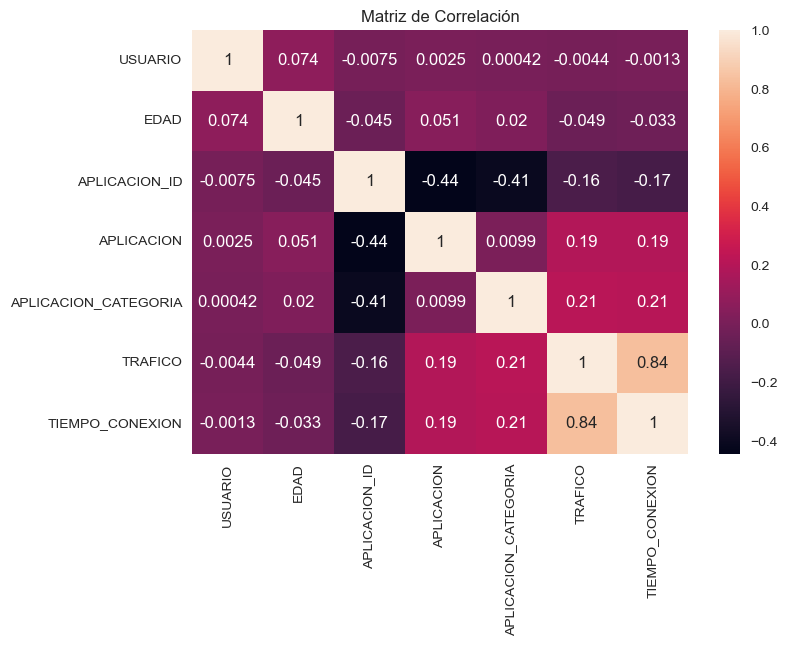

In [252]:
ax = sns.heatmap(tigo_df1_corr.corr(), annot=True).set(title='Matriz de Correlación')

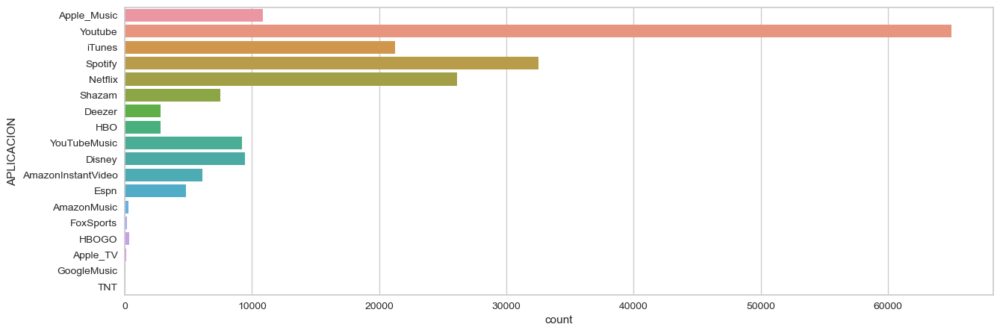

In [253]:
plt.figure(1 , figsize = (15 , 5))
sns.countplot(y = 'APLICACION' , data = tigo_df1)
plt.show()

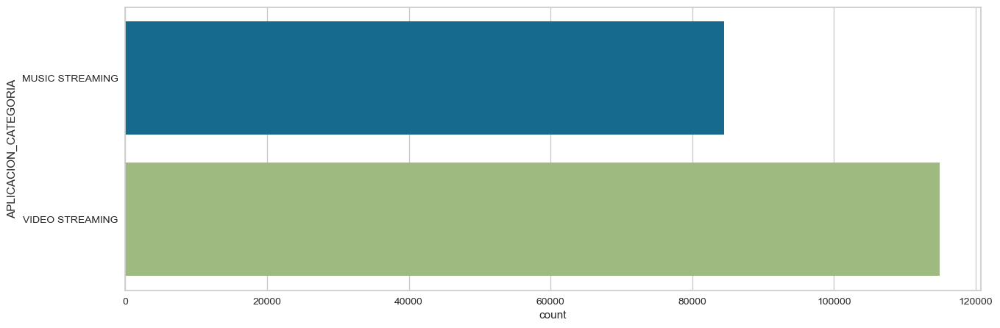

In [254]:
plt.figure(1 , figsize = (15 , 5))
sns.countplot(y = 'APLICACION_CATEGORIA' , data = tigo_df1)
plt.show()

[Text(0.5, 1.0, 'BoxPlot Edad')]

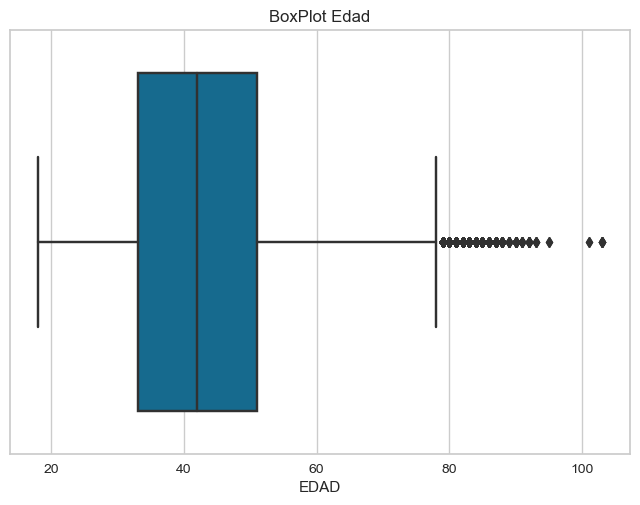

In [255]:
sns.boxplot(x=tigo_df1["EDAD"] , data=tigo_df1).set(title='BoxPlot Edad')

<AxesSubplot:xlabel='TRAFICO'>

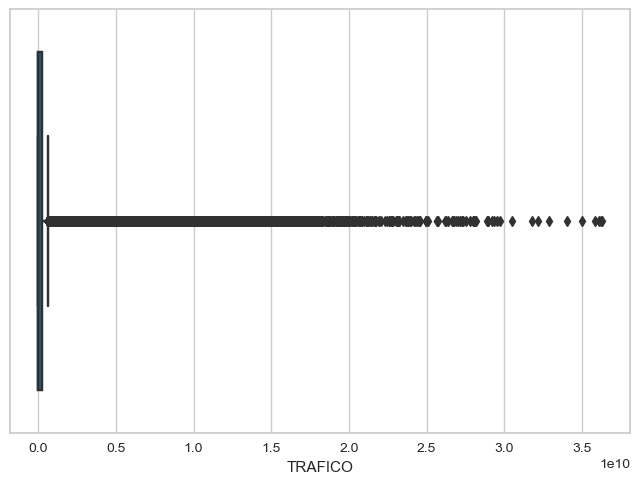

In [256]:
sns.boxplot(x=tigo_df1["TRAFICO"] , data=tigo_df1)

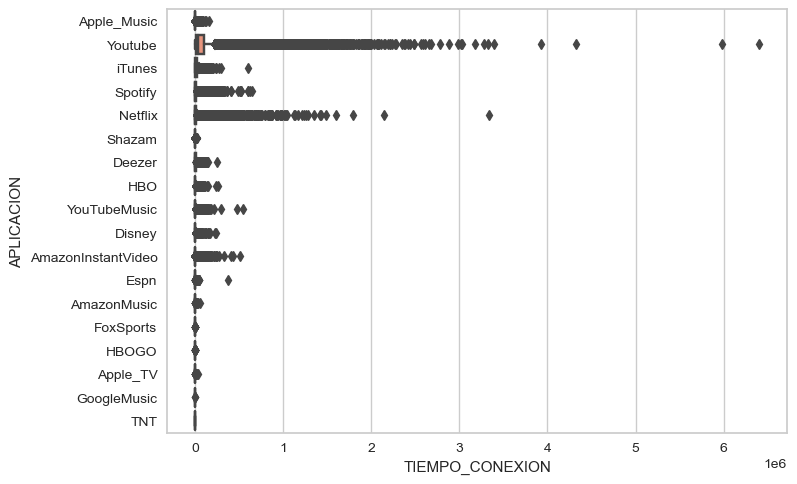

In [ ]:
sns.boxplot( y=tigo_df1["APLICACION"], x=tigo_df1["TIEMPO_CONEXION"] );
plt.show()

## 3.3 Selección de carateristicas

In [ ]:
#Creating a Dataframe to work with K-Means, this subset will be the one that I will clean and prepare since I dont need any other columns.
x_1 = tigo_df1.copy()
x_1 = x_1.drop("USUARIO",axis=1)
x_1 = x_1.drop("APLICACION",axis=1)
x_1 = x_1.drop("APLICACION_CATEGORIA",axis=1)
x_1.head()

,EDAD,APLICACION_ID,TRAFICO,TIEMPO_CONEXION
0,35.0,1004,64814,69.0
1,45.0,373,301331822,18778.0
2,38.0,312,2229342,547.0
3,38.0,373,16147037,2131.0
4,38.0,1004,18931,56.0


In [ ]:
# Final inspection to determine if the data set is ready to work with K-Means.
profile = ProfileReport(x_1, title="Profiling Report")
profile.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

# 4. Elaboración del Modelo K-Means y aplicación del mismo

#### Para llevar a cabo la tarea de segmentación del comportamiento de los clientes, recurrimos a tecnicas de agrupamiento (Clustering), este es un algoritmo del tipo "Aprendizaje no supervisado". Especificamente en este caso aplicaremos K-Means, siendo este es las común en las tareas de Clustering, cual agrupa los datos basados en similitudes.
#### El K-means se puede aplicar utilizando características relevantes como la edad, el consumo de datos y el tiempo de conexión. Estas características pueden proporcionar información sobre los diferentes patrones de uso de las aplicaciones de streaming por parte de los clientes.

#### Se debe tomar en cuenta igual la posibilidad de realizar un PCA (Analisis de las componentes principales) en conjunto con K-Means. Este mismo reduce la dimensionalidad de los datos y las transforma en conjuntos no correlacionados que pueden aplicarse el metodo de K-Means para realizar la segmentación.

#### Aclarado todo el concepto basico, se debe determinar el numero de Clusteres, para ello usaremos el metodo del codo  para encontrar la mejor cantidad de grupos que capturen la variabilidad de nuestros datos.

## 4.1 Elaboración y prueba de posibles conjuntos

In [ ]:
#Created a new dataset to test Clustering without the Aplication ID
x_2 = x_1.copy()
x_2 = x_2.drop("APLICACION_ID",axis=1)
x_2.head()

,EDAD,TRAFICO,TIEMPO_CONEXION
0,35.0,64814,69.0
1,45.0,301331822,18778.0
2,38.0,2229342,547.0
3,38.0,16147037,2131.0
4,38.0,18931,56.0


In [ ]:
# Since we have different kinds of data in the set, its mandatory to use a scaling system. Also taking in consideration that this is NOT an Gaussian distribution, we should then use Normalization methods like MinMaxScaler. 
# Not using a scaling system or failing to use an appropiate system can lead to huge misleading in the problem(Ex: Using Standarization in this situation will cause a misleading answer).
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
x_1_scaled = scaler.fit_transform(x_1)
x_2_scaled = scaler.fit_transform(x_2)


In [ ]:
#Analyzing the effect of scaling aplication ID
x_2_scaled

array([[2.00000000e-01, 1.75285825e-06, 1.06214534e-05],
       [3.17647059e-01, 8.30748359e-03, 2.93292693e-03],
       [2.35294118e-01, 6.14274534e-05, 8.52840231e-05],
       ...,
       [3.64705882e-01, 1.62596636e-02, 2.82062068e-03],
       [3.64705882e-01, 2.00255371e-06, 1.24958276e-06],
       [3.64705882e-01, 3.06141876e-04, 1.07667174e-03]])

In [ ]:
#Analyzing the effect of scaling aplication ID, as expected is creating noise. Descarting x_1 as a clustering dataset.
x_1_scaled

array([[2.00000000e-01, 6.23853211e-01, 1.75285825e-06, 1.06214534e-05],
       [3.17647059e-01, 9.75813178e-02, 8.30748359e-03, 2.93292693e-03],
       [2.35294118e-01, 4.67055880e-02, 6.14274534e-05, 8.52840231e-05],
       ...,
       [3.64705882e-01, 0.00000000e+00, 1.62596636e-02, 2.82062068e-03],
       [3.64705882e-01, 4.10341952e-01, 2.00255371e-06, 1.24958276e-06],
       [3.64705882e-01, 4.67055880e-02, 3.06141876e-04, 1.07667174e-03]])

# 4.2 Determinación de cantidad de clusters del modelo (Hyperparameter Tuning)

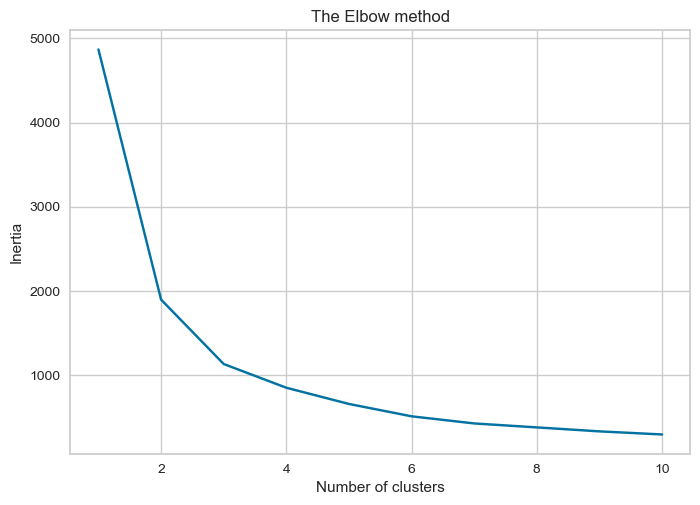

In [ ]:
# Importing KMeans and determining the number of clustering through the use of the elbow method considering the Inertia.
from sklearn.cluster import KMeans

#Within cluster sum of squares (Inertia)
wcss = []

for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', 
                    max_iter = 300, n_init = 10, random_state = 42)
    kmeans.fit(x_2_scaled)
    wcss.append(kmeans.inertia_)
    
# Plotting the results onto a line graph, 
# Allowing us to observe 'The elbow'
plt.plot(range(1, 11), wcss)
plt.title('The Elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()


In [ ]:
# Tester for Clusters
min_clusters = 2
max_clusters = 4

best_score = -1
best_model = None
best_clusters = None


for n_clusters in range(min_clusters, max_clusters+1):
    
    model = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = model.fit_predict(x_2_scaled)
    
    
    silhouette_avg = silhouette_score(x_2_scaled, cluster_labels)
    
    
    if silhouette_avg > best_score:
        best_score = silhouette_avg
        best_model = model
        best_clusters = n_clusters

cluster_labels = best_model.labels_

# Do not forget to update this part!

tigo_df2 = tigo_df1.copy()
tigo_df2['K_Means_Label'] = cluster_labels

#Answers
print(f"El mejor número de clusters encontrado: {best_clusters}")
print(f"Índice de Silhouette: {best_score}")
print(data.head())

# 4.3 Entrenamiento del modelo para ambos posibles valores

In [222]:
# 3 Clusters Model
model = KMeans(n_clusters=3, random_state=42)
cluster_labels = model.fit_predict(x_2_scaled)
silhouette_avg = silhouette_score(x_2_scaled, cluster_labels)
silhouette_avg

0.5019248855094804

In [225]:
# 3 Clusters Model
inertia = model.inertia_
inertia

1135.8119319604518

In [226]:
# 2 Clusters Model
model_2 = KMeans(n_clusters=2, random_state=42)
cluster_labels_2 = model_2.fit_predict(x_2_scaled)
silhouette_avg_2 = silhouette_score(x_2_scaled, cluster_labels_2)
silhouette_avg_2

0.5440654582335428

In [228]:
# 2 Clusters Model
inertia = model_2.inertia_
inertia

1899.5054080425912

In [230]:
cluster_labels_2

array([1, 1, 1, ..., 0, 0, 0])

In [232]:
tigo_df2.shape

(200000, 7)

# Hipotesis 1: 2 Clusters

In [259]:
tigo_2_cluster = tigo_df1.copy()
tigo_2_cluster['K_Means_Label'] = cluster_labels_2
tigo_2_cluster

,USUARIO,EDAD,APLICACION_ID,APLICACION,APLICACION_CATEGORIA,TRAFICO,TIEMPO_CONEXION,K_Means_Label
0,347095500,35.0,1004,Apple_Music,MUSIC STREAMING,64814,69.0,1
1,347102885,45.0,373,Youtube,VIDEO STREAMING,301331822,18778.0,1
2,347103445,38.0,312,iTunes,MUSIC STREAMING,2229342,547.0,1
3,347103445,38.0,373,Youtube,VIDEO STREAMING,16147037,2131.0,1
4,347103445,38.0,1004,Apple_Music,MUSIC STREAMING,18931,56.0,1
...,...,...,...,...,...,...,...,...
199995,385616605,43.0,373,Youtube,VIDEO STREAMING,825265705,44810.0,1
199996,385628825,49.0,927,AmazonInstantVideo,VIDEO STREAMING,513841,111.0,0
199997,385628825,49.0,256,Netflix,VIDEO STREAMING,589774771,18059.0,0
199998,385628825,49.0,748,Spotify,MUSIC STREAMING,73871,9.0,0


In [305]:
#Grouped Data
pd.set_option('display.max_columns', None)  

tigo_2c_grouped = tigo_2_cluster.copy()
tigo_2c_grouped = tigo_2c_grouped.drop("USUARIO",axis=1)
tigo_2c_grouped = tigo_2c_grouped.drop("APLICACION",axis=1)
tigo_2c_grouped = tigo_2c_grouped.drop("APLICACION_CATEGORIA",axis=1)
tigo_2c_grouped = tigo_2c_grouped.drop("APLICACION_ID",axis=1)
tigo_2c_grouped.groupby("K_Means_Label").agg([np.mean, np.median, min, max])


EDAD                           TRAFICO                     
                    mean median   min    max          mean      median   min   
K_Means_Label                                                                  
0              56.200771   54.0  46.0  103.0  3.988237e+08  13126298.0  1234  \
1              34.859650   35.0  18.0   47.0  5.482573e+08  13568889.5  1234   

                           TIEMPO_CONEXION                          
                       max            mean  median  min        max  
K_Means_Label                                                       
0              36272186989    29561.497856  1884.5  1.0  6402138.0  
1              36069593098    37510.755198  2002.0  1.0  5977533.0

In [351]:
tigo_2_grouped = tigo_2_cluster.groupby(['K_Means_Label',"APLICACION"],sort=True)['APLICACION'].count()
tigo_2_grouped

K_Means_Label  APLICACION        
0              AmazonInstantVideo     2036
               AmazonMusic              89
               Apple_Music            4114
               Apple_TV                 33
               Deezer                  997
               Disney                 3176
               Espn                   1757
               FoxSports                46
               GoogleMusic              16
               HBO                     885
               HBOGO                    85
               Netflix                9115
               Shazam                 2585
               Spotify               12266
               TNT                       1
               YouTubeMusic           3280
               Youtube               27010
               iTunes                 8551
1              AmazonInstantVideo     4088
               AmazonMusic             219
               Apple_Music            6751
               Apple_TV                 72
               Deeze

In [260]:
#Using a Profiling report for an esier inspection of the data, useful with large datasets.
profile = ProfileReport(tigo_2_cluster, title="Profiling Report")
profile.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

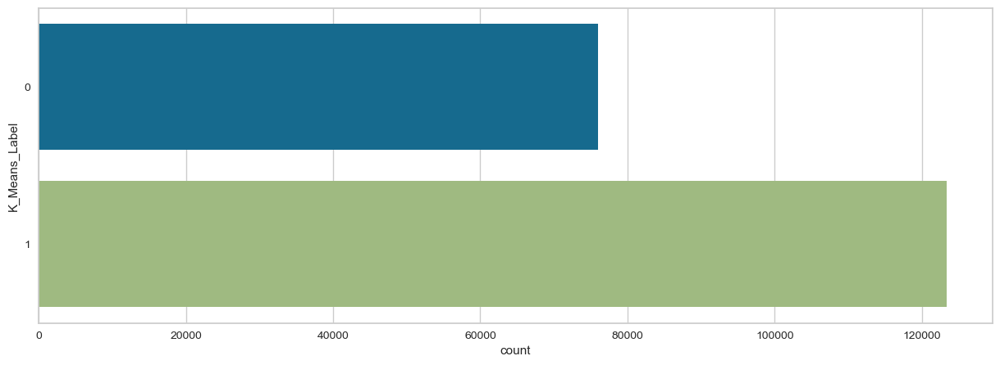

In [310]:
plt.figure(1 , figsize = (15 , 5))
sns.countplot(y = 'K_Means_Label' , data = tigo_2_cluster)
plt.show()

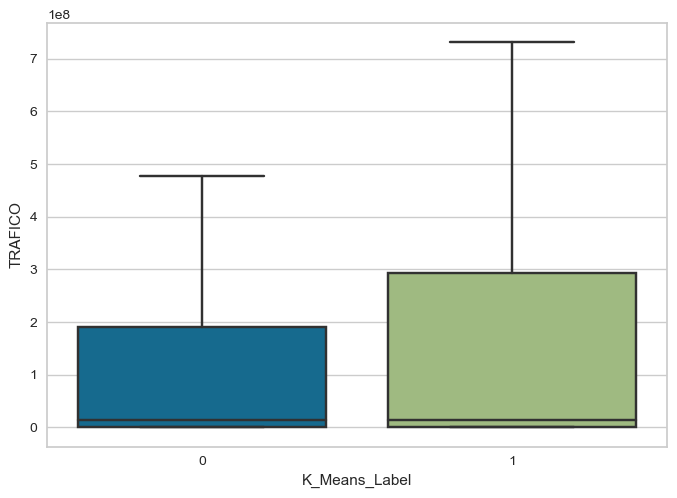

In [368]:
sns.boxplot( x=tigo_2_cluster["K_Means_Label"], y=tigo_2_cluster["TRAFICO"], showfliers=False);
plt.show()

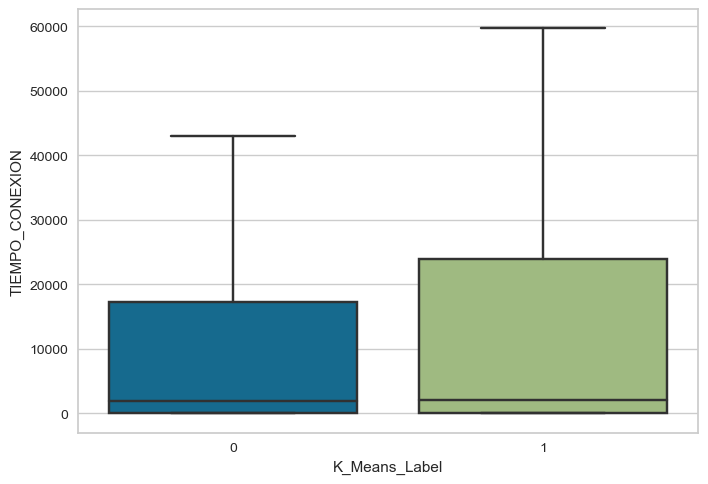

In [369]:
sns.boxplot( x=tigo_2_cluster["K_Means_Label"], y=tigo_2_cluster["TIEMPO_CONEXION"], showfliers=False);
plt.show()

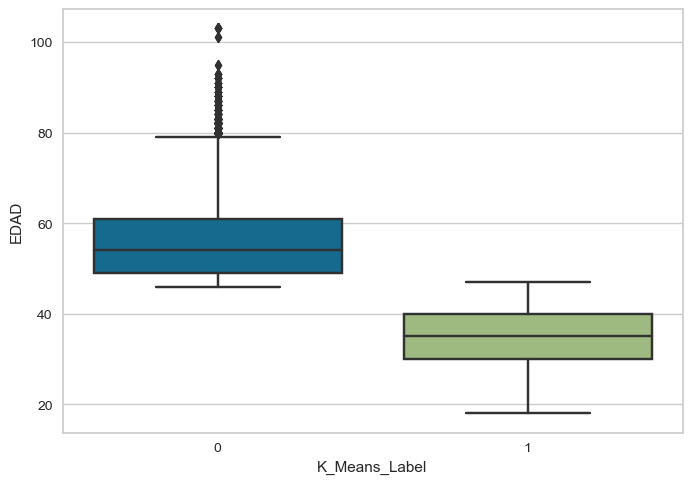

In [309]:
sns.boxplot( x=tigo_2_cluster["K_Means_Label"], y=tigo_2_cluster["EDAD"] );
plt.show()

<AxesSubplot:xlabel='count', ylabel='APLICACION'>

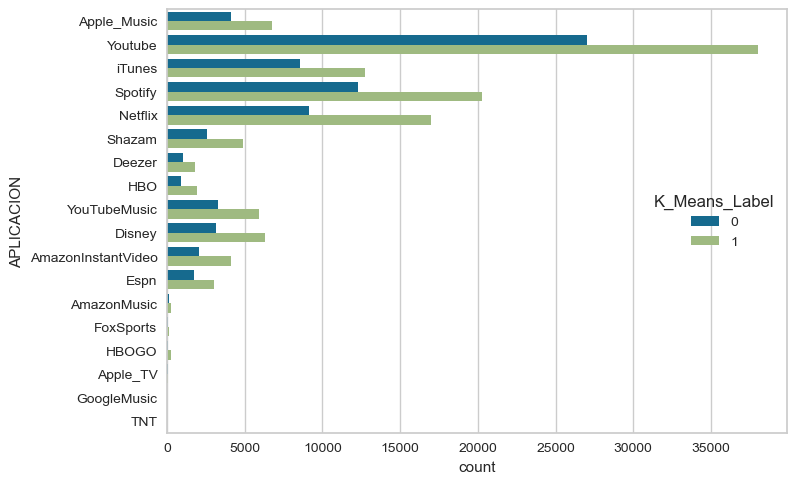

In [355]:
sns.countplot(data=tigo_2_cluster, y="APLICACION", hue="K_Means_Label")


In [276]:
labels2 = model_2.labels_

import plotly.express as px

fig=px.scatter_3d(data_frame=tigo_2_cluster,x='EDAD',y='TRAFICO',z='TIEMPO_CONEXION',color=labels2, color_continuous_scale='bluered')
fig.update_layout(
    title={
        'text': 'Segmentación de clientes según la edad, Trafico de datos y tiempo de conexión',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

# Hipotesis 2: 3 Clusters

In [270]:
tigo_3_cluster = tigo_df1.copy()
tigo_3_cluster['K_Means_Label'] = cluster_labels
tigo_3_cluster

,USUARIO,EDAD,APLICACION_ID,APLICACION,APLICACION_CATEGORIA,TRAFICO,TIEMPO_CONEXION,K_Means_Label
0,347095500,35.0,1004,Apple_Music,MUSIC STREAMING,64814,69.0,1
1,347102885,45.0,373,Youtube,VIDEO STREAMING,301331822,18778.0,0
2,347103445,38.0,312,iTunes,MUSIC STREAMING,2229342,547.0,1
3,347103445,38.0,373,Youtube,VIDEO STREAMING,16147037,2131.0,1
4,347103445,38.0,1004,Apple_Music,MUSIC STREAMING,18931,56.0,1
...,...,...,...,...,...,...,...,...
199995,385616605,43.0,373,Youtube,VIDEO STREAMING,825265705,44810.0,0
199996,385628825,49.0,927,AmazonInstantVideo,VIDEO STREAMING,513841,111.0,0
199997,385628825,49.0,256,Netflix,VIDEO STREAMING,589774771,18059.0,0
199998,385628825,49.0,748,Spotify,MUSIC STREAMING,73871,9.0,0


In [360]:
#Grouped Data
pd.set_option('display.max_columns', None)  

tigo_3c_grouped = tigo_3_cluster.copy()
tigo_3c_grouped = tigo_3c_grouped.drop("USUARIO",axis=1)
tigo_3c_grouped = tigo_3c_grouped.drop("APLICACION",axis=1)
tigo_3c_grouped = tigo_3c_grouped.drop("APLICACION_CATEGORIA",axis=1)
tigo_3c_grouped = tigo_3c_grouped.drop("APLICACION_ID",axis=1)
tigo_3c_grouped.groupby("K_Means_Label").agg([np.mean, np.median, min, max])


EDAD                           TRAFICO                     
                    mean median   min    max          mean      median   min   
K_Means_Label                                                                  
0              45.629527   45.0  39.0   54.0  4.416021e+08  12102016.0  1234  \
1              31.151704   32.0  18.0   39.0  5.812246e+08  14616510.0  1234   
2              63.117495   62.0  55.0  103.0  4.036046e+08  14079655.0  1234   

                           TIEMPO_CONEXION                          
                       max            mean  median  min        max  
K_Means_Label                                                       
0              36272186989    31955.433167  1857.0  1.0  6402138.0  
1              34029672158    39052.724805  2100.0  1.0  5977533.0  
2              34976136489    30019.334520  1891.5  1.0  3329509.0

In [271]:
#Using a Profiling report for an esier inspection of the data, useful with large datasets.
profile = ProfileReport(tigo_3_cluster, title="Profiling Report")
profile.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

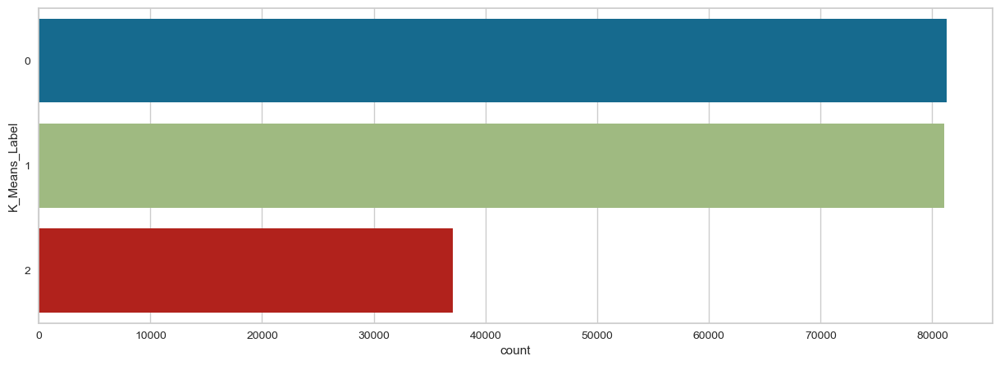

In [357]:
plt.figure(1 , figsize = (15 , 5))
sns.countplot(y = 'K_Means_Label' , data = tigo_3_cluster)
plt.show()

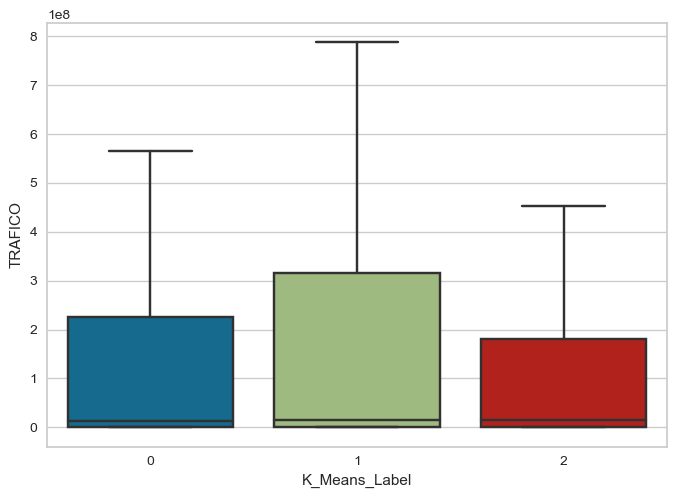

In [366]:
sns.boxplot( x=tigo_3_cluster["K_Means_Label"], y=tigo_3_cluster["TRAFICO"], showfliers=False);
plt.show()

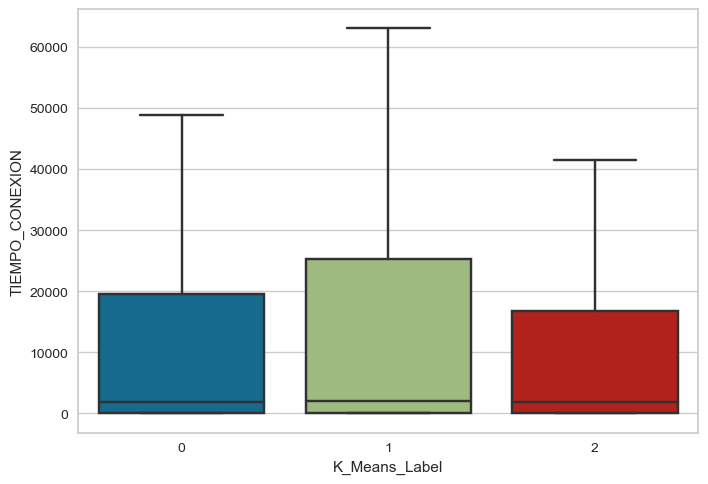

In [365]:
sns.boxplot( x=tigo_3_cluster["K_Means_Label"], y=tigo_3_cluster["TIEMPO_CONEXION"], showfliers=False);
plt.show()

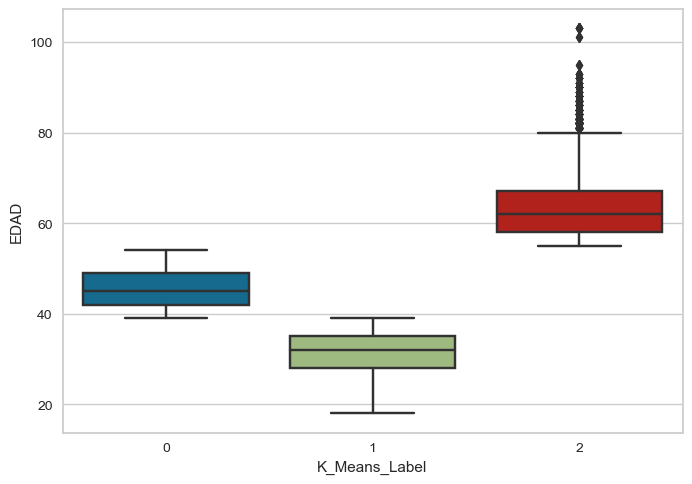

In [361]:
sns.boxplot( x=tigo_3_cluster["K_Means_Label"], y=tigo_3_cluster["EDAD"] );
plt.show()

<AxesSubplot:xlabel='count', ylabel='APLICACION'>

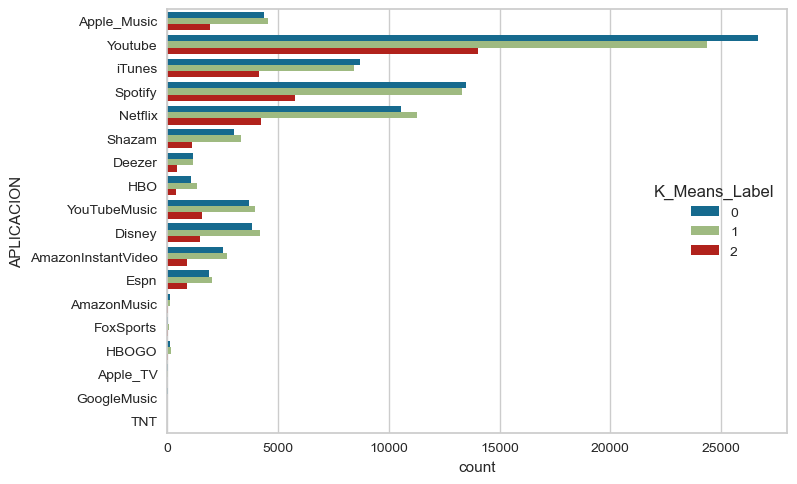

In [358]:
sns.countplot(data=tigo_3_cluster, y="APLICACION", hue="K_Means_Label")


In [275]:
labels3 = model.labels_

import plotly.express as px

fig=px.scatter_3d(data_frame=tigo_2_cluster,x='EDAD',y='TRAFICO',z='TIEMPO_CONEXION',color=labels3, color_continuous_scale='bluered')
fig.update_layout(
    title={
        'text': 'Segmentación de clientes según la edad, Trafico de datos y tiempo de conexión',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()